In [2]:
import cdflib
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from itertools import cycle
from chaosmagpy.data_utils import timestamp, mjd2000
from datetime import datetime

#import struct

oersted_path = 'oersted_data/Oersted_vect_rtp_15sec_v1.all'

from mpl_toolkits.axes_grid1.inset_locator import inset_axes
import cartopy.crs as ccrs
from lib.solar_emphemeris import *
import warnings 
warnings.filterwarnings('ignore')
from hp30client import getKpindex
import cartopy.crs as ccrs
from mpl_toolkits.axes_grid1.inset_locator import inset_axes

dst_path = "disturbance_indices\Dst_MJD_1998.dat"

from alberte_klara_lib import do_design, plot_map_three, plot_map_one


<>:23: SyntaxWarning: invalid escape sequence '\D'
<>:23: SyntaxWarning: invalid escape sequence '\D'
C:\Users\klara\AppData\Local\Temp\ipykernel_3560\3614506493.py:23: SyntaxWarning: invalid escape sequence '\D'
  dst_path = "disturbance_indices\Dst_MJD_1998.dat"


# Reading .all file

In [23]:
# Open the file and print only the first few lines of . all file

with open(oersted_path, 'r') as file:
    for _ in range(10):  # Print the first 10 lines
        print(file.readline(), end='')

        

%    t [md2000]    r [km] theta [deg]   phi [deg]       B_r   B_theta     B_phi       
%                                                          observed field     
  -291.57628381  7190.022    26.39630    46.22090 -37207.28  -9013.57   1139.70 
  -291.57380112  7167.631    14.44520    32.39300 -38969.43  -6027.33    829.11 
  -291.57340704  7163.910    12.67250    28.07390 -39170.05  -5696.74    270.60 
  -291.57302609  7160.282    11.03820    22.66770 -39367.09  -5336.84   -142.70 
  -291.57281590  7158.268    10.18420    18.98450 -39477.70  -5130.06   -405.14 
  -291.57263200  7156.498     9.47450    15.24480 -39580.40  -4909.45   -634.89 
  -291.57244809  7154.725     8.80860    10.93390 -39683.63  -4683.94   -873.68 
  -291.57226417  7152.949     8.19760     5.96330 -39787.97  -4451.95  -1112.02 


# Converting .all to .txt

In [5]:
# Open the input .all file for reading
#with open(oersted_path, 'r') as input_file:
    # Read the contents of the .all file
    #all_contents = input_file.read()

# Write the contents to a new .txt file
#with open('oersted_data/Oersted_vect_rtp_15sec_v1.txt', 'w') as output_file:
    # Write the contents to the .txt file
    #output_file.write(all_contents)

In [6]:
# saving txt file in variable

#oersted_path = 'oersted_data/Oersted_vect_rtp_15sec_v1.txt'

#with open(oersted_path, 'r') as input_file:
#    oersted_data = input_file.read()

# Make dataframe

In [5]:
# ''' This Section is outcommented to reduce cpu usage
#     If desire to create new dataframe with the oersted data, run this code'''

# data_oersted = "oersted_data\Oersted_vect_rtp_15sec_v1.all"
# data = pd.read_csv(data_oersted, comment = '%', sep='\s+')

# df = data.copy()
# new_headers = ["time_stamp", "r", "theta", "phi", "B_r", "B_theta", "B_phi"]
# df.columns = new_headers

# #Saving datafram so i do not have to run this code every time
# df.to_csv('oersted_dataframe.csv', index=False)

# df.head()

,time_stamp,r,theta,phi,B_r,B_theta,B_phi
0,-291.573801,7167.631,14.4452,32.3930,-38969.43,-6027.33,829.11
1,-291.573407,7163.910,12.6725,28.0739,-39170.05,-5696.74,270.60
2,-291.573026,7160.282,11.0382,22.6677,-39367.09,-5336.84,-142.70
3,-291.572816,7158.268,10.1842,18.9845,-39477.70,-5130.06,-405.14
4,-291.572632,7156.498,9.4745,15.2448,-39580.40,-4909.45,-634.89


In [24]:
#load dataframe

df = pd.read_csv('oersted_data/oersted_dataframe.csv')

print(df.shape)
df.head()       

(5482497, 7)


,time_stamp,r,theta,phi,B_r,B_theta,B_phi
0,-291.573801,7167.631,14.4452,32.3930,-38969.43,-6027.33,829.11
1,-291.573407,7163.910,12.6725,28.0739,-39170.05,-5696.74,270.60
2,-291.573026,7160.282,11.0382,22.6677,-39367.09,-5336.84,-142.70
3,-291.572816,7158.268,10.1842,18.9845,-39477.70,-5130.06,-405.14
4,-291.572632,7156.498,9.4745,15.2448,-39580.40,-4909.45,-634.89


# Finding when Swarm started recoridng data

In [9]:
np.max(df['time_stamp'])

2286.39878287

In [25]:
# Downsample data to every minute


df = df.iloc[::4,:]    # 4 is every minute

pre_filtered_data_length = len(df);
print('remaining data points:', pre_filtered_data_length)

remaining data points: 1370625


(1370625,)


Text(0.5, 1.0, 'Down-sampled Oersted data')

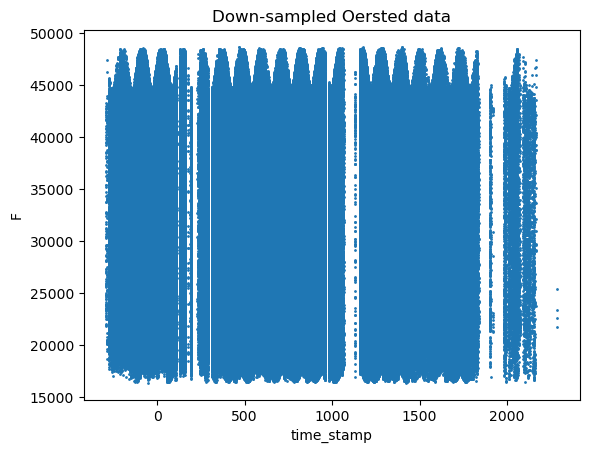

In [27]:
F = np.sqrt(df['B_r']**2 + df['B_theta']**2 + df['B_phi']**2)
print(F.shape)

# Plotting
plt.scatter(df['time_stamp'], F, s=1)
plt.xlabel('time_stamp')
plt.ylabel('F')
plt.title('Down-sampled Oersted data')



In [28]:
# identifying the 'gaps'

# Sort the data based on t
sorted_data = sorted(zip(df['time_stamp'], F), key=lambda x: x[0])


#Define minimum gap threshold
min_gap_threshold = 60  # Adjust this threshold as needed

# Initialize variables
gaps = []

# Iterate through sorted data to identify gaps
for i in range(len(sorted_data) - 1):
    gap_size = sorted_data[i+1][0] - sorted_data[i][0] - 1
    if gap_size >= min_gap_threshold:
        gap_start = sorted_data[i][0] + 1
        gap_end = sorted_data[i+1][0] - 1
        gaps.append((gap_start, gap_end))

# Print gaps
if gaps:
    print("Gaps in data:")
    for gap in gaps:
        print(f"From t = {gap[0]} to t = {gap[1]}")
else:
    print("No gaps found in the data.")

Gaps in data:
From t = 1068.57148413 to t = 1129.34677243
From t = 1838.15041215 to t = 1901.99318225
From t = 1919.16887472 to t = 1981.2499369
From t = 2167.85313029 to t = 2285.39275307


Text(0.5, 1.0, 'Down-sampled Oersted data with gaps of threshold = 60')

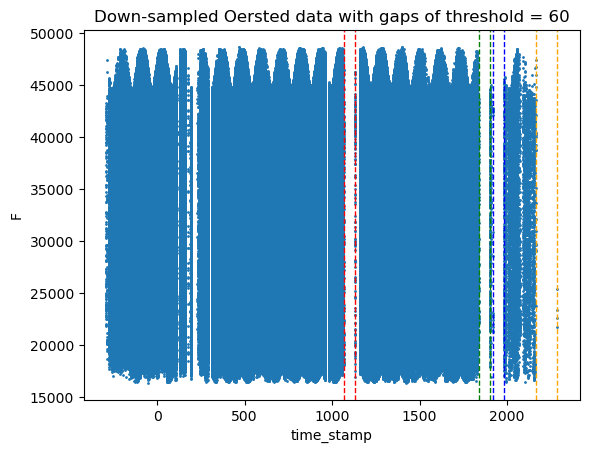

In [13]:
#Define colors for the gaps
colors = cycle(['red', 'green', 'blue', 'orange', 'purple', 'cyan', 'magenta', 'yellow'])

plt.scatter(df['time_stamp'], F, s=1, label = 'Oersted data')
# Add vertical lines for gaps
for gap, color in zip(gaps, colors):
    plt.axvline(x=gap[0], color=color, linestyle='--', linewidth=1)
    plt.axvline(x=gap[1], color=color, linestyle='--', linewidth=1)
plt.xlabel('time_stamp')
plt.ylabel('F')
plt.title(f'Down-sampled Oersted data with gaps of threshold = {min_gap_threshold}')
#plt.legend()

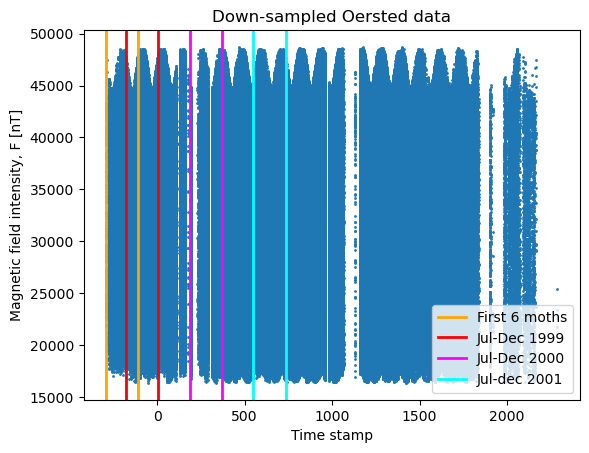

In [32]:
#colors = cycle(['red', 'green', 'blue', 'orange', 'purple', 'cyan', 'magenta', 'yellow'])

plt.scatter(df['time_stamp'], F, s=1)
# Add vertical lines for gaps
plt.axvline(df['time_stamp'][0], color='orange', linestyle='-', linewidth=2, label='First 6 moths')
plt.axvline(df['time_stamp'][0]+184, color='orange', linestyle='-', linewidth=2)
plt.axvline(-180, color='red', linestyle='-', linewidth=2, label='Jul-Dec 1999')
plt.axvline(-180+184, color='red', linestyle='-', linewidth=2)
plt.axvline(-180+365.25, color='magenta', linestyle='-', linewidth=2, label='Jul-Dec 2000')
plt.axvline(-180+365.25+184, color='magenta', linestyle='-', linewidth=2)
plt.axvline(-180+365.25*2, color='cyan', linestyle='-', linewidth=2, label='Jul-dec 2001')
plt.axvline(-180+365.25*2+184, color='cyan', linestyle='-', linewidth=2)
plt.xlabel('Time stamp')
plt.ylabel('Magnetic field intensity, F [nT]')
plt.title(f'Down-sampled Oersted data')
plt.legend()


plt.savefig('oersted_figures/oersted_differet_times/field_time_gaps.png')

In [15]:
#Plotting all data for ørsted, to check

#plot_map_one(F, df['phi'], df['theta'], sat = 'Ørsted', title = 'title', label = 'Field intensity [nT]', scatter_size = 40)


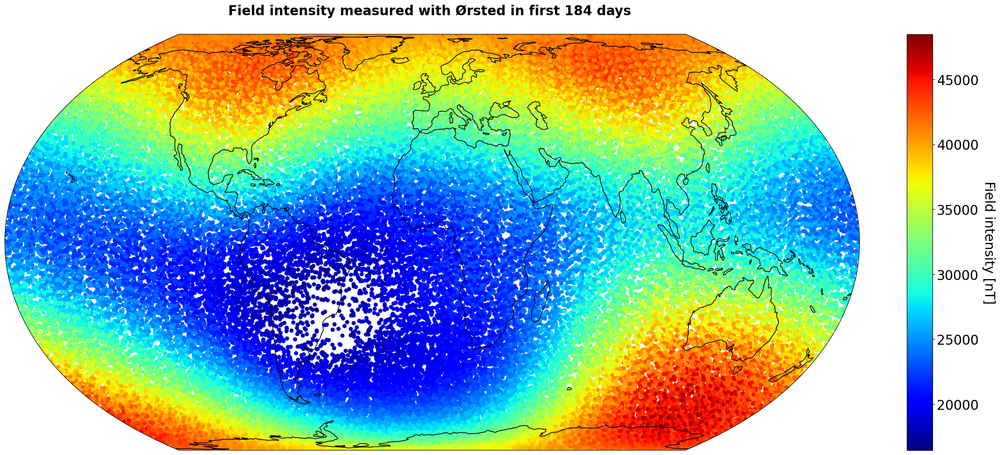

In [29]:
# first 184 day

duration = np.ceil(df['time_stamp'].iloc[0] + 184)
end_time = np.where(np.ceil(df['time_stamp']) == duration)[0][-1]

udsnit = df.iloc[:end_time]
F_udsnit = np.sqrt(udsnit['B_r']**2 + udsnit['B_theta']**2 + udsnit['B_phi']**2)

#plot_map_one(F_udsnit, udsnit['phi'], udsnit['theta'], sat = 'Ørsted', title = 'title', label = 'Field intensity [nT]', scatter_size=40)

fig = plt.figure(figsize=(25, 25))
gs = fig.add_gridspec(2, 2)

axes = []
axes.append(plt.subplot(gs[0, :], projection=ccrs.EqualEarth()))

for ax in axes:
        pc = ax.scatter(udsnit['phi'], y=90-udsnit['theta'], s = 40, c = F_udsnit, edgecolors='none', cmap='jet', transform = ccrs.PlateCarree());
        ax.coastlines(linewidth=1.1);

plt.title('Field intensity measured with Ørsted in first 184 days \n', weight='bold', fontsize=20);

cax = inset_axes(axes[-1], width="3%", height="100%", loc='right',
                    borderpad=-11)

clb = plt.colorbar(pc, cax=cax)
clb.ax.tick_params(labelsize=20)
clb.set_label('Field intensity [nT]', rotation=270, labelpad=25, fontsize=20)

# plt.savefig('oersted_figures/oersted_differet_times/F_first184.png')

Closest Index: 1357343
Closest Value: 1820.02040144


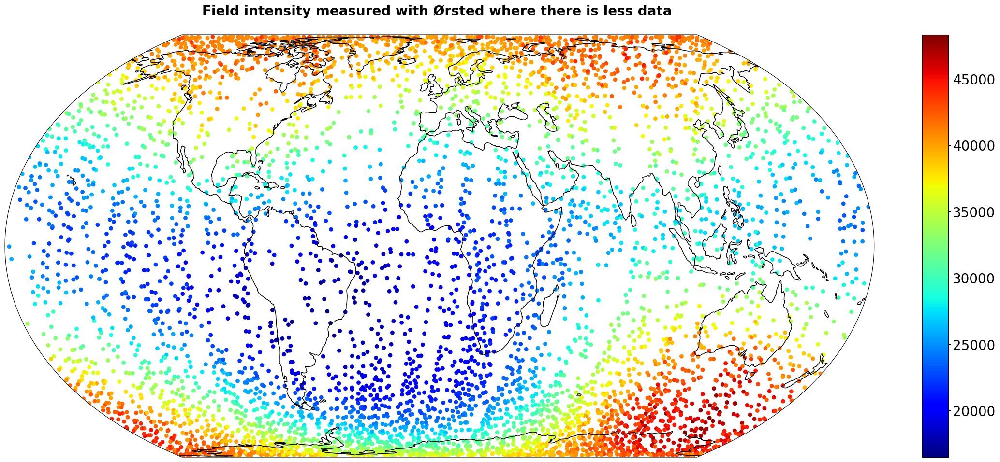

In [9]:
# Find the index corresponding to the closest value to 1820 in the 'time_stamp' column
closest_index = np.argmin(np.abs(df['time_stamp'] - 1820))
closest_value = df['time_stamp'].iloc[closest_index]

print("Closest Index:", closest_index)
print("Closest Value:", closest_value)

if closest_index is not None:
    # Calculate the duration based on the closest start time
    duration = np.ceil(df['time_stamp'].iloc[closest_index] + 184)

    # Find the closest value to the calculated duration in the 'time_stamp' column
    closest_duration_index = np.argmin(np.abs(df['time_stamp'] - duration))
    closest_duration_value = df['time_stamp'].iloc[closest_duration_index]

    # Extract the data within the specified time interval
    if closest_duration_index > closest_index:
        udsnit = df.iloc[closest_index:closest_duration_index + 1]
    else:
        udsnit = df.iloc[closest_duration_index:closest_index + 1]

    F_udsnit = np.sqrt(udsnit['B_r']**2 + udsnit['B_theta']**2 + udsnit['B_phi']**2)

    # Plot the data
    #plot_map_one(F_udsnit, udsnit['phi'], udsnit['theta'], sat='Ørsted', title='title', label='Field intensity [nT]')
    fig = plt.figure(figsize=(25, 25))
    gs = fig.add_gridspec(2, 2)

    axes = []
    axes.append(plt.subplot(gs[0, :], projection=ccrs.EqualEarth()))

    for ax in axes:
            pc = ax.scatter(udsnit['phi'], y=90-udsnit['theta'], s = 40, c = F_udsnit, edgecolors='none', cmap='jet', transform = ccrs.PlateCarree());
            ax.coastlines(linewidth=1.1);

    plt.title('Field intensity measured with Ørsted where there is less data \n', weight='bold', fontsize=20);

    cax = inset_axes(axes[-1], width="3%", height="100%", loc='right',
                        borderpad=-11)

    clb = plt.colorbar(pc, cax=cax)
    clb.ax.tick_params(labelsize=20)
else:
    print("No rows found in the DataFrame.")

Closest Index: 36712
Closest Value: -180.59296666


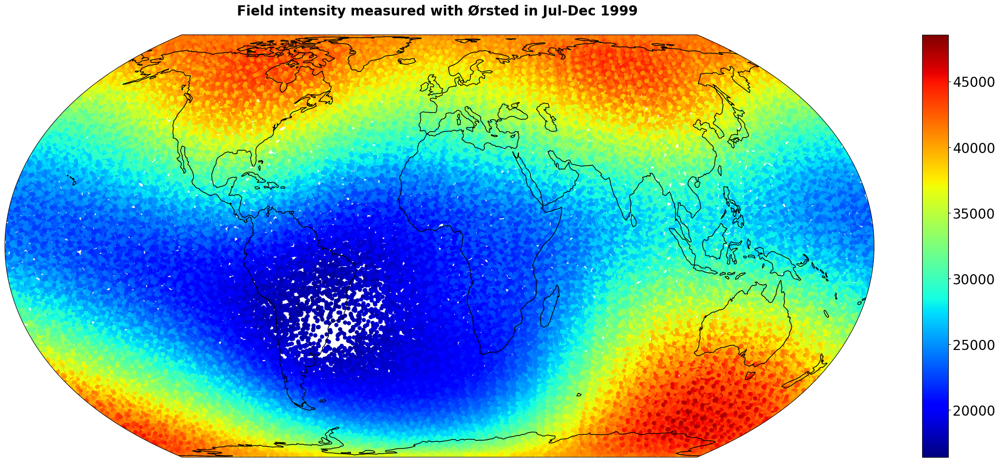

In [18]:
# Oersted data from june to december 1999

# Find the index corresponding to the closest value to 100 in the 'time_stamp' column
closest_index = np.argmin(np.abs(df['time_stamp'] - (-180)))
closest_value = df['time_stamp'].iloc[closest_index]

print("Closest Index:", closest_index)
print("Closest Value:", closest_value)

if closest_index is not None:
    # Calculate the duration based on the closest start time
    duration = np.ceil(df['time_stamp'].iloc[closest_index] + 184)

    # Find the closest value to the calculated duration in the 'time_stamp' column
    closest_duration_index = np.argmin(np.abs(df['time_stamp'] - duration))
    closest_duration_value = df['time_stamp'].iloc[closest_duration_index]

    # Extract the data within the specified time interval
    if closest_duration_index > closest_index:
        udsnit = df.iloc[closest_index:closest_duration_index + 1]
    else:
        udsnit = df.iloc[closest_duration_index:closest_index + 1]

    F_udsnit = np.sqrt(udsnit['B_r']**2 + udsnit['B_theta']**2 + udsnit['B_phi']**2)

    # Plot the data
    #plot_map_one(F_udsnit, udsnit['phi'], udsnit['theta'], sat='Ørsted', title='title', label='Field intensity [nT]')
    fig = plt.figure(figsize=(25, 25))
    gs = fig.add_gridspec(2, 2)

    axes = []
    axes.append(plt.subplot(gs[0, :], projection=ccrs.EqualEarth()))

    for ax in axes:
            pc = ax.scatter(udsnit['phi'], y=90-udsnit['theta'], s = 40, c = F_udsnit, edgecolors='none', cmap='jet', transform = ccrs.PlateCarree());
            ax.coastlines(linewidth=1.1);

    plt.title('Field intensity measured with Ørsted in Jul-Dec 1999 \n', weight='bold', fontsize=20);

    cax = inset_axes(axes[-1], width="3%", height="100%", loc='right',
                        borderpad=-11)

    clb = plt.colorbar(pc, cax=cax)
    clb.ax.tick_params(labelsize=20)
else:
    print("No rows found in the DataFrame.")

plt.savefig('oersted_figures/oersted_differet_times/F_jun_dec_99.png')

Closest Index: 324170
Closest Value: 187.1299634


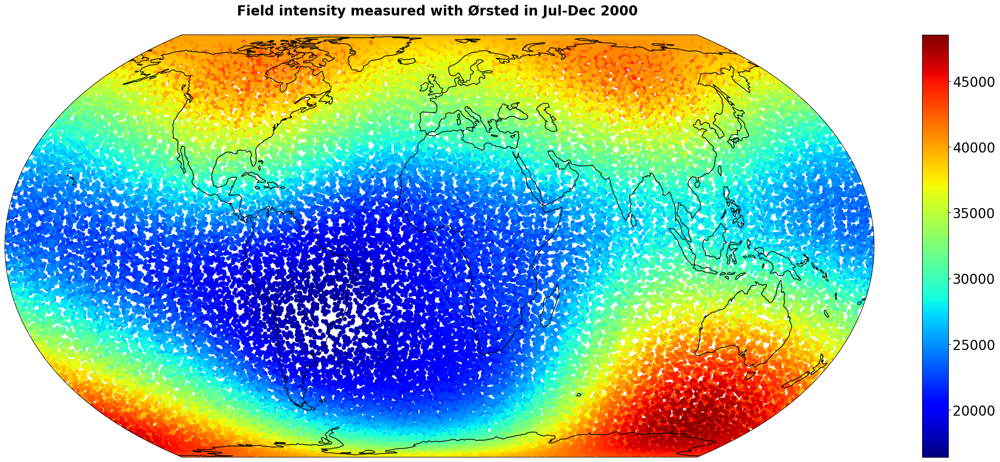

In [19]:
# jun-dec 2000

closest_index = np.argmin(np.abs(df['time_stamp'] - (-180+365.25)))
closest_value = df['time_stamp'].iloc[closest_index]

print("Closest Index:", closest_index)
print("Closest Value:", closest_value)

if closest_index is not None:
    # Calculate the duration based on the closest start time
    duration = np.ceil(df['time_stamp'].iloc[closest_index] + 184)

    # Find the closest value to the calculated duration in the 'time_stamp' column
    closest_duration_index = np.argmin(np.abs(df['time_stamp'] - duration))
    closest_duration_value = df['time_stamp'].iloc[closest_duration_index]

    # Extract the data within the specified time interval
    if closest_duration_index > closest_index:
        udsnit = df.iloc[closest_index:closest_duration_index + 1]
    else:
        udsnit = df.iloc[closest_duration_index:closest_index + 1]

    F_udsnit = np.sqrt(udsnit['B_r']**2 + udsnit['B_theta']**2 + udsnit['B_phi']**2)

    # Plot the data
    #plot_map_one(F_udsnit, udsnit['phi'], udsnit['theta'], sat='Ørsted', title='title', label='Field intensity [nT]')
    fig = plt.figure(figsize=(25, 25))
    gs = fig.add_gridspec(2, 2)

    axes = []
    axes.append(plt.subplot(gs[0, :], projection=ccrs.EqualEarth()))

    for ax in axes:
            pc = ax.scatter(udsnit['phi'], y=90-udsnit['theta'], s = 40, c = F_udsnit, edgecolors='none', cmap='jet', transform = ccrs.PlateCarree());
            ax.coastlines(linewidth=1.1);

    plt.title('Field intensity measured with Ørsted in Jul-Dec 2000 \n', weight='bold', fontsize=20);

    cax = inset_axes(axes[-1], width="3%", height="100%", loc='right',
                        borderpad=-11)

    clb = plt.colorbar(pc, cax=cax)
    clb.ax.tick_params(labelsize=20)
else:
    print("No rows found in the DataFrame.")

plt.savefig('oersted_figures/oersted_differet_times/F_jun_dec_00.png')

Closest Index: 566720
Closest Value: 550.50023866


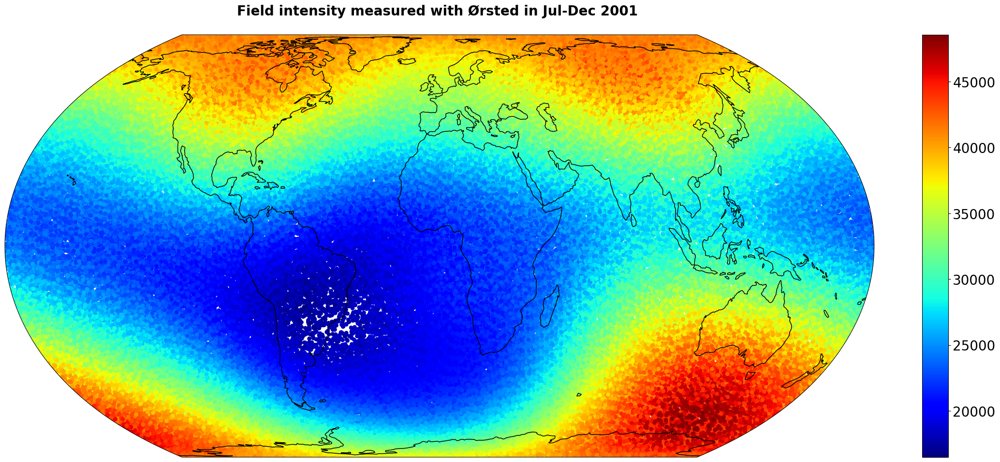

In [20]:
# jun-dec 2001

closest_index = np.argmin(np.abs(df['time_stamp'] - (-180+365.25*2)))
closest_value = df['time_stamp'].iloc[closest_index]

print("Closest Index:", closest_index)
print("Closest Value:", closest_value)

if closest_index is not None:
    # Calculate the duration based on the closest start time
    duration = np.ceil(df['time_stamp'].iloc[closest_index] + 184)

    # Find the closest value to the calculated duration in the 'time_stamp' column
    closest_duration_index = np.argmin(np.abs(df['time_stamp'] - duration))
    closest_duration_value = df['time_stamp'].iloc[closest_duration_index]

    # Extract the data within the specified time interval
    if closest_duration_index > closest_index:
        udsnit = df.iloc[closest_index:closest_duration_index + 1]
    else:
        udsnit = df.iloc[closest_duration_index:closest_index + 1]

    F_udsnit = np.sqrt(udsnit['B_r']**2 + udsnit['B_theta']**2 + udsnit['B_phi']**2)

    # Plot the data
    #plot_map_one(F_udsnit, udsnit['phi'], udsnit['theta'], sat='Ørsted', title='title', label='Field intensity [nT]')
    fig = plt.figure(figsize=(25, 25))
    gs = fig.add_gridspec(2, 2)

    axes = []
    axes.append(plt.subplot(gs[0, :], projection=ccrs.EqualEarth()))

    for ax in axes:
            pc = ax.scatter(udsnit['phi'], y=90-udsnit['theta'], s = 40, c = F_udsnit, edgecolors='none', cmap='jet', transform = ccrs.PlateCarree());
            ax.coastlines(linewidth=1.1);

    plt.title('Field intensity measured with Ørsted in Jul-Dec 2001 \n', weight='bold', fontsize=20);

    cax = inset_axes(axes[-1], width="3%", height="100%", loc='right',
                        borderpad=-11)

    clb = plt.colorbar(pc, cax=cax)
    clb.ax.tick_params(labelsize=20)
else:
    print("No rows found in the DataFrame.")

plt.savefig('oersted_figures/oersted_differet_times/F_jun_dec_01.png')

Closest Index: 360763
Closest Value: 330.00122207


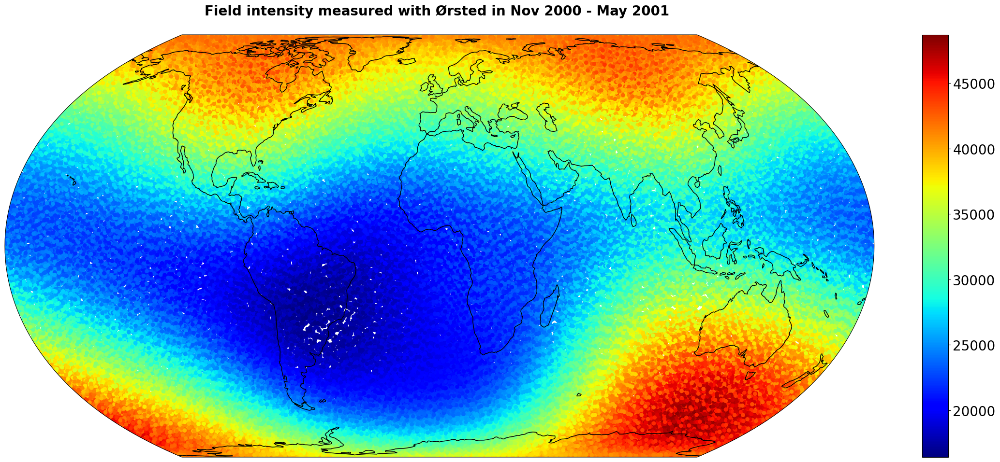

In [21]:
# nov-may 2000, 2001

closest_index = np.argmin(np.abs(df['time_stamp'] - (330)))
closest_value = df['time_stamp'].iloc[closest_index]

print("Closest Index:", closest_index)
print("Closest Value:", closest_value)

if closest_index is not None:
    # Calculate the duration based on the closest start time
    duration = np.ceil(df['time_stamp'].iloc[closest_index] + 184)

    # Find the closest value to the calculated duration in the 'time_stamp' column
    closest_duration_index = np.argmin(np.abs(df['time_stamp'] - duration))
    closest_duration_value = df['time_stamp'].iloc[closest_duration_index]

    # Extract the data within the specified time interval
    if closest_duration_index > closest_index:
        udsnit = df.iloc[closest_index:closest_duration_index + 1]
    else:
        udsnit = df.iloc[closest_duration_index:closest_index + 1]

    F_udsnit = np.sqrt(udsnit['B_r']**2 + udsnit['B_theta']**2 + udsnit['B_phi']**2)

    # Plot the data
    #plot_map_one(F_udsnit, udsnit['phi'], udsnit['theta'], sat='Ørsted', title='title', label='Field intensity [nT]')
    fig = plt.figure(figsize=(25, 25))
    gs = fig.add_gridspec(2, 2)

    axes = []
    axes.append(plt.subplot(gs[0, :], projection=ccrs.EqualEarth()))

    for ax in axes:
            pc = ax.scatter(udsnit['phi'], y=90-udsnit['theta'], s = 40, c = F_udsnit, edgecolors='none', cmap='jet', transform = ccrs.PlateCarree());
            ax.coastlines(linewidth=1.1);

    plt.title('Field intensity measured with Ørsted in Nov 2000 - May 2001 \n', weight='bold', fontsize=20);

    cax = inset_axes(axes[-1], width="3%", height="100%", loc='right',
                        borderpad=-11)

    clb = plt.colorbar(pc, cax=cax)
    clb.ax.tick_params(labelsize=20)
else:
    print("No rows found in the DataFrame.")

plt.savefig('oersted_figures/oersted_differet_times/F_nov_may_01.png')

In [21]:
timestamp(-0.008746)

numpy.datetime64('1999-12-31T23:47:24.345600')

In [37]:
# Defining new dataset with Oersted data from june to december

#closest_index = np.argmin(np.abs(df['time_stamp'] - (-180)))            # jun-dec 1999
# closest_index = np.argmin(np.abs(df['time_stamp'] - (-180+365.25)))     # jun-dec 2000
# closest_index = np.argmin(np.abs(df['time_stamp'] - (-180+365.25*2)))   # jun-dec 2001
#closest_index = np.argmin(np.abs(df['time_stamp'] - (330)))             # nov-may 2000-2001

# closest_index = np.argmin(np.abs(df['time_stamp']))                # first year, jan-dec 2000
# duration = np.ceil(df['time_stamp'].iloc[closest_index] + 366) # 2000 was a leap year

closest_index = np.argmin(np.abs(df['time_stamp'] - 366) )               # second year, jan-dec 2001. 2000 was a leap year
duration = np.ceil(df['time_stamp'].iloc[closest_index] + 365)



# Find the closest value to the calculated duration in the 'time_stamp' column
closest_duration_index = np.argmin(np.abs(df['time_stamp'] - duration))

# Extract the data within the specified time interval
interval_slice = slice(min(closest_index, closest_duration_index), max(closest_index, closest_duration_index) + 1)
dataframe = df.iloc[interval_slice]

print(dataframe.shape)
print(dataframe.head())
print('\nFirst data point recorded at: ' + str(timestamp(dataframe['time_stamp'].iloc[0])))

(357556, 7)
         time_stamp         r    theta       phi       B_r   B_theta    B_phi
1544472  366.000186  7185.463  61.6536 -113.9432 -25777.66 -17747.37  3304.66
1544476  366.000922  7180.040  65.3868 -114.7366 -23177.51 -18633.49  3367.54
1544480  366.001657  7174.381  69.1277 -115.5001 -20456.58 -19413.21  3404.78
1544484  366.002393  7168.511  72.8762 -116.2402 -17642.30 -20071.65  3431.59
1544488  366.003247  7161.462  77.2366 -117.0769 -14270.30 -20688.57  3468.50

First data point recorded at: 2001-01-01T00:00:16.084224


# Filtering data

In [38]:
X = -dataframe['B_theta']
Y = dataframe['B_phi']
Z = -dataframe['B_r']


# Add X, Y, and Z as new columns to the DataFrame
dataframe['X'] = X
dataframe['Y'] = Y
dataframe['Z'] = Z

print(dataframe.shape)
dataframe.head()

(357556, 10)


,time_stamp,r,theta,phi,B_r,B_theta,B_phi,X,Y,Z
1544472,366.000186,7185.463,61.6536,-113.9432,-25777.66,-17747.37,3304.66,17747.37,3304.66,25777.66
1544476,366.000922,7180.040,65.3868,-114.7366,-23177.51,-18633.49,3367.54,18633.49,3367.54,23177.51
1544480,366.001657,7174.381,69.1277,-115.5001,-20456.58,-19413.21,3404.78,19413.21,3404.78,20456.58
1544484,366.002393,7168.511,72.8762,-116.2402,-17642.30,-20071.65,3431.59,20071.65,3431.59,17642.30
1544488,366.003247,7161.462,77.2366,-117.0769,-14270.30,-20688.57,3468.50,20688.57,3468.50,14270.30


In [39]:
# renaming, r, tehta, and phi

dataframe = dataframe.rename(columns={'r': 'radius'})
dataframe = dataframe.rename(columns={'theta': 'colat'})
dataframe = dataframe.rename(columns={'phi': 'lon'})

print(dataframe.shape)
dataframe.head()

(357556, 10)


,time_stamp,radius,colat,lon,B_r,B_theta,B_phi,X,Y,Z
1544472,366.000186,7185.463,61.6536,-113.9432,-25777.66,-17747.37,3304.66,17747.37,3304.66,25777.66
1544476,366.000922,7180.040,65.3868,-114.7366,-23177.51,-18633.49,3367.54,18633.49,3367.54,23177.51
1544480,366.001657,7174.381,69.1277,-115.5001,-20456.58,-19413.21,3404.78,19413.21,3404.78,20456.58
1544484,366.002393,7168.511,72.8762,-116.2402,-17642.30,-20071.65,3431.59,20071.65,3431.59,17642.30
1544488,366.003247,7161.462,77.2366,-117.0769,-14270.30,-20688.57,3468.50,20688.57,3468.50,14270.30


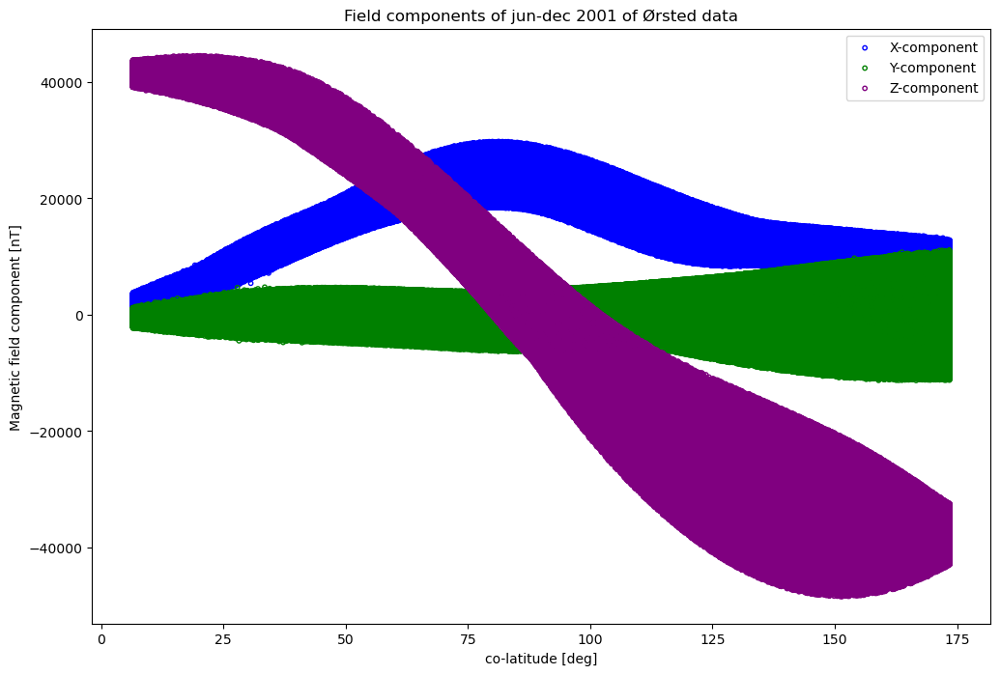

<Figure size 640x480 with 0 Axes>

In [25]:
plt.figure(figsize=(12, 8))
plt.scatter(dataframe['colat'].values, dataframe['X'], s = 10, facecolors='none', edgecolors='blue', label = 'X-component')
plt.scatter(dataframe['colat'].values, dataframe['Y'], s = 10, facecolors='none', edgecolors='green', label = 'Y-component')
plt.scatter(dataframe['colat'].values, dataframe['Z'], s = 10, facecolors='none', edgecolors='purple', label = 'Z-component')

plt.ylabel('Magnetic field component [nT]')
plt.xlabel('co-latitude [deg]')
plt.title('Field components of jun-dec 2001 of Ørsted data')
plt.legend()
plt.show()

plt.savefig('oersted_figures/field_components_oersted')

In [40]:
# removing sunlit data
rad = np.pi/180
zenith = 90-10  # zenith angle 80 deg

# threshold for dark time observation
cos_zeta_0 = np.cos((zenith) * rad)
_, declination = sun_mjd2000(dataframe.time_stamp.values)

cos_zeta = []
cos_zeta = ( np.cos(dataframe['colat'].values * rad) * np.sin(declination) \
        + np.sin(dataframe['colat'].values * rad) * np.cos(declination) \
        * np.cos(np.mod(dataframe['time_stamp'].values + .5, 1) * 2*np.pi + dataframe['lon'].values * rad) )

dataframe = dataframe.loc[cos_zeta <= cos_zeta_0].copy()


In [41]:
# Quiet-time selection with Dst and Hp30

# Time interval of interest
startdate_whole = timestamp(dataframe['time_stamp'].iloc[0])
enddate_whole = timestamp(dataframe['time_stamp'].iloc[-1])
startdate = np.datetime64(startdate_whole, 'D') # ensure correct length
enddate = np.datetime64(enddate_whole, 'D')

# Get Dst indices
time_Dst, Dst = np.loadtxt(dst_path, usecols=(0,1), comments='#',unpack=True)

# Put into pandas dataframe for easy access
Dst_indices = pd.DataFrame({'time_Dst': time_Dst, 'Dst': Dst})

# Calculating the hourly difference between all Dst measurements.
Dst_indices['Dst_Hourly_Difference'] = Dst_indices.Dst.diff();

# Interpolating all the Dst hourly difference measurements within the time period of our Swarm data measurements. The Dst measurements span a 1 hour interval, they are interpolated so 1 hourly difference value is assigned to each 1 minute Swarm data measurement.
dataframe['dDst'] = np.abs(np.interp(dataframe.time_stamp.values, Dst_indices.time_Dst.values, Dst_indices.Dst_Hourly_Difference.values));


# Get Hp30 indices
time_Hp30, Hp30, _ = getKpindex(str(startdate), str(enddate), 'Hp30')

# Convert time to mjd2000
stamp = []
for i in np.arange(0, len(time_Hp30)):
    yr1, mn1, dt1 = time_Hp30[i].split("-")
    hr1, min1, _ = time_Hp30[i].split(":")
    stamp.append(to_mjd2000(int(yr1), int(mn1), int(dt1[:2]), int(hr1[-2:]), int(min1)))

Hp30_indices = pd.DataFrame({'time_Hp30': stamp, 'Hp30': Hp30})

# Interpolating all the Hp measurements within the time period of our Swarm data measurements
dataframe['Hp30'] = np.interp(dataframe.time_stamp.values, Hp30_indices.time_Hp30.values, Hp30_indices.Hp30.values);

# Extract data, which is not quiet
dataframe = dataframe.query('Hp30 <= 3.5 & dDst <= 3.5')

dataframe['F'] = np.sqrt(dataframe['X']**2+dataframe['Y']**2+dataframe['Z']**2)

dataframe.head()

,time_stamp,radius,colat,lon,B_r,B_theta,B_phi,X,Y,Z,dDst,Hp30,F
1544716,366.045415,7169.562,61.2410,42.7035,-20018.21,-21715.57,696.16,21715.57,696.16,20018.21,3.380095,0.333,29542.839247
1544720,366.046151,7175.330,57.4999,41.8649,-22794.86,-20488.69,812.18,20488.69,812.18,22794.86,3.062324,0.333,30660.262502
1544724,366.046886,7180.887,53.7676,40.9776,-25260.73,-19174.04,912.91,19174.04,912.91,25260.73,2.744549,0.333,31726.671662
1544728,366.047622,7186.213,50.0451,40.0291,-27438.83,-17798.54,994.82,17798.54,994.82,27438.83,2.426786,0.333,32721.049566
1544732,366.048358,7191.287,46.3326,39.0029,-29335.48,-16411.96,1058.68,16411.96,1058.68,29335.48,2.109015,0.333,33630.991975


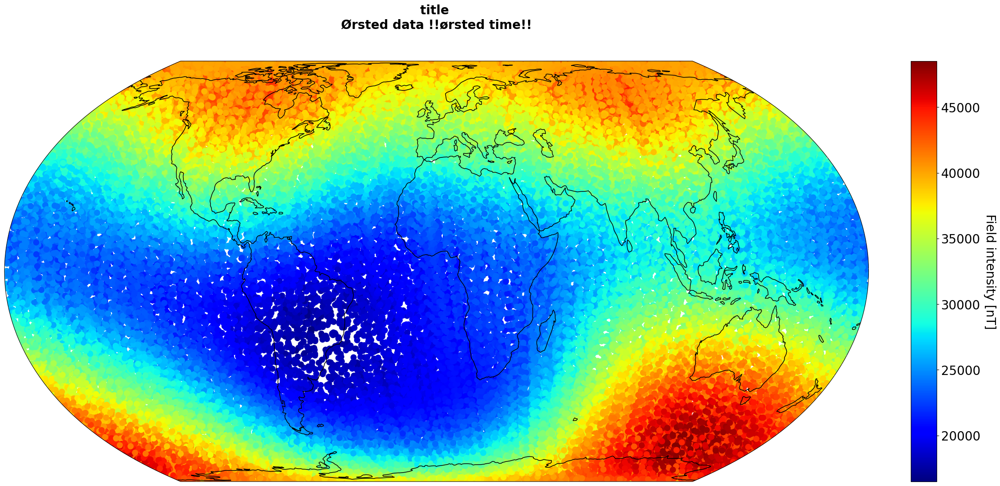

In [26]:
plot_map_one(dataframe['F'], dataframe['lon'], dataframe['colat'], sat='Ørsted', title='title', label='Field intensity [nT]', scatter_size=100)

## Investigating whether data selction will make residuals better
more like swarm, concentrated at the poles

(30000, 195)
(30000, 195)
(30000, 195)
(30000, 195)
(30000, 195)
(30000, 195)
(30000, 195)
(30000, 195)
(30000, 195)
(30000, 195)
(30000, 195)
(30000, 195)
(30000, 195)
(30000, 195)


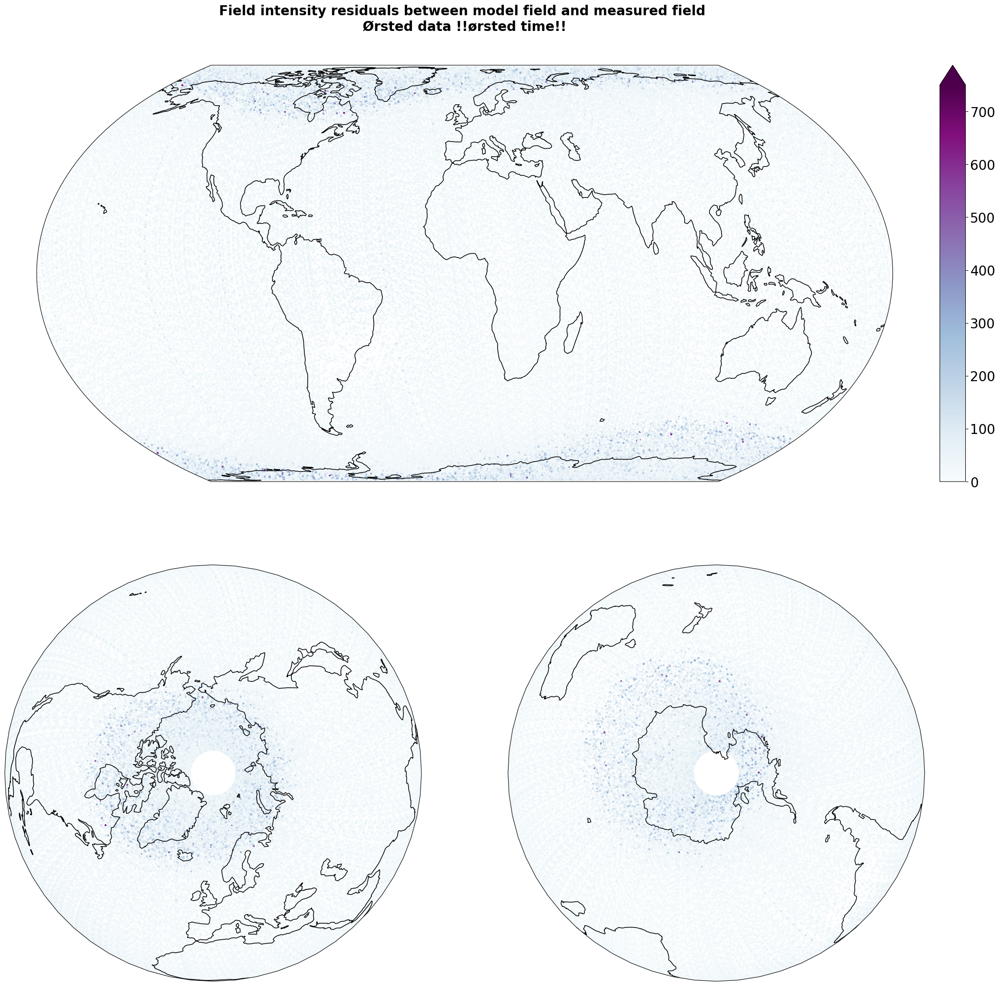

In [42]:
from chaosmagpy.model_utils import design_gauss
n_ext_max = 1
n_int_max = 13

data = dataframe.copy()
data['B_radius'] = -data['Z'];
data['B_theta'] = -data['X'];
data['B_phi'] = data['Y'];

nm_static = (n_int_max + 1)**2 - 1 + (n_ext_max + 1)**2 - 1
n_obs = len(data)

# lhs and rhs of lst sq prb will have to be constructed bit by bit
# allocating these in memory
lhs = np.zeros((nm_static, nm_static)) # G.T@G
rhs = np.zeros((nm_static,)) # G.T@d

# taking 10k data point at a time (sub matrix, chunk of data, G_sub) - but still all model parameters
i = 0
while (i <= n_obs - 10*10**3):
    i10k = i + 10*10**3

    G_int = np.vstack((design_gauss(data['radius'].iloc[i:i10k], data['colat'].iloc[i:i10k], data['lon'].iloc[i:i10k], nmax=n_int_max)))
    print(G_int.shape)
    G_ext = np.vstack((design_gauss(data['radius'].iloc[i:i10k], data['colat'].iloc[i:i10k], data['lon'].iloc[i:i10k], nmax=n_ext_max, source = 'external')))
    G = np.hstack((G_int, G_ext))
    lhs += G.T@G

    d = np.hstack((data['B_radius'].iloc[i:i10k], data['B_theta'].iloc[i:i10k], data['B_phi'].iloc[i:i10k]))
    rhs += G.T@d
    i += 10*10**3

G_int = np.vstack((design_gauss(data['radius'].iloc[i:], data['colat'].iloc[i:], data['lon'].iloc[i:], nmax=n_int_max)))
G_ext = np.vstack((design_gauss(data['radius'].iloc[i:], data['colat'].iloc[i:], data['lon'].iloc[i:], nmax=n_ext_max, source = 'external')))
G = np.hstack((G_int, G_ext))
lhs += G.T@G

d = np.hstack((data['B_radius'].iloc[i:], data['B_theta'].iloc[i:], data['B_phi'].iloc[i:]))
rhs += G.T@d


m = np.linalg.solve(lhs, rhs)

m_int_static = m[:-((n_ext_max + 1)**2 - 1)]
m_ext_static = m[-((n_ext_max + 1)**2 - 1):]



# Predicted field at Swarm altitude
G_pred_static_radius, G_pred_static_theta, G_pred_static_phi = do_design(data['radius'], data['colat'], data['lon'], 13, 1)

b_pred_static_radius = G_pred_static_radius @ m
b_pred_static_theta = G_pred_static_theta @ m
b_pred_static_phi = G_pred_static_phi @ m

# Residuals
residuals_r_static = data['B_radius'] - b_pred_static_radius
residuals_t_static = data['B_theta'] - b_pred_static_theta
residuals_p_static = data['B_phi'] - b_pred_static_phi


# Intensity of residuals on map
F_residuals = np.sqrt(residuals_r_static**2 + residuals_t_static**2 + residuals_p_static**2)

plot_map_three(F_residuals, data['lon'], data['colat'], 'Oersted', 'Field intensity residuals between model field and measured field', 'Residuals [nT]', scatter_size = 10, clim=[0, 750], colors='BuPu')

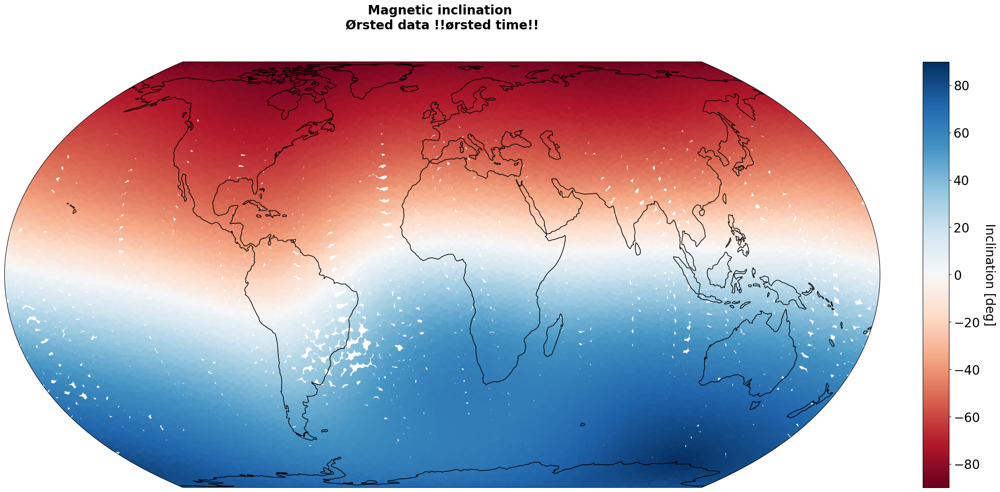

In [29]:
# Magnetic inclination

H = np.sqrt(dataframe['X']**2 + dataframe['Y']**2) # H = sqrt(X^2 + Y^2)
I = np.arctan(-dataframe['Z']/H)*180/np.pi


plot_map_one(I, dataframe['lon'], dataframe['colat'], 'oersted', 'Magnetic inclination', 'Inclination [deg]', scatter_size = 100, colors = 'RdBu')

# plt.savefig('oersted_figures/oersted_mag_inc.png')

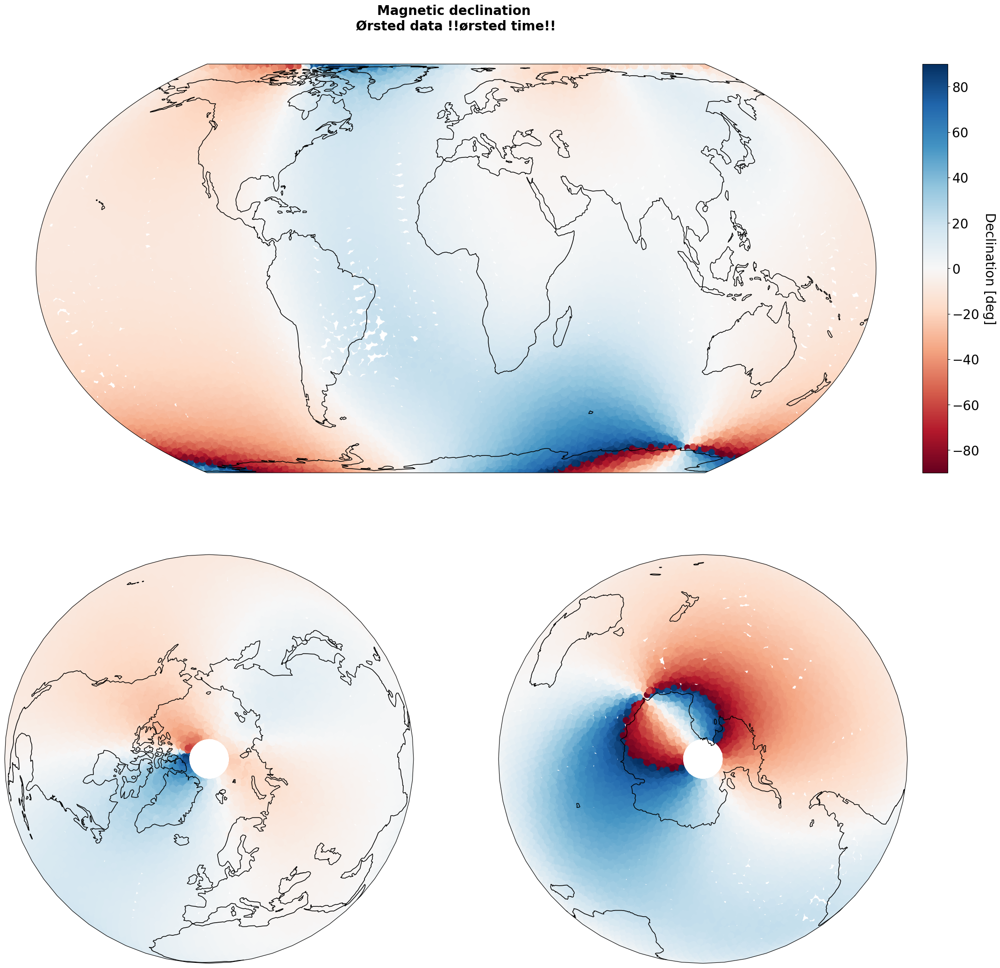

In [30]:
D = np.arctan(dataframe['Y']/(-dataframe['X']))*180/np.pi


plot_map_three(D, dataframe['lon'], dataframe['colat'], 'oersted', 'Magnetic declination', 'Declination [deg]', scatter_size = 100, colors = 'RdBu')

plt.savefig('oersted_figures/oersted_mag_dec.png')

In [43]:
dataframe['B_radius'] = -dataframe['Z'];
dataframe['B_theta'] = -dataframe['X'];
dataframe['B_phi'] = dataframe['Y'];

# REMEMBER, CHANGE NAME
dataframe.to_csv('ready_oersted_data/oersted_dark_quiet_2001.txt', index = False, sep = ',')